In [1]:
:ext TypeSynonymInstances
:ext FlexibleInstances
:ext LambdaCase

In [2]:
import Data.Text (pack)
import Data.Tuple.Extra (first, second, (***), (&&&))
import Data.List.Extra (dropEnd, enumerate, nub)
-- import Control.Monad.Trans.State
import Control.Monad.Trans.Class (lift)
import Data.IORef
import qualified Data.Map as Map

In [3]:
import Utils
import Tyche.Model
import Tyche.Dist
import Tyche.Prelude
import Tyche.Prob
import Tyche.Inference.Enumerate
-- import qualified System.Random.MWC.Probability as MWC

In [4]:
import Graphics.Vega.VegaLite hiding (filter, lookup, repeat, FontWeight(Normal))
import qualified Graphics.Vega.VegaLite as VL (filter, lookup, repeat, FontWeight(Normal))

# Setting Things Up

## The Model

**Worlds** are distinguished only by the height of John

In [5]:
data World = World {label :: String, ht :: Int, std :: Int} deriving Eq

In [6]:
instance Ord World where
  w <= w' = ht w <= ht w'

instance Show World where
  show (World l _ _) = l

We assume speakers reason simultaneously about John's height and the distribution of the comparison class, so **indices** pair a world together with a comparison class. The possible comparison classes are assumed to be normally distributed, all with the same standard deviation, so we represent them here simply by their mean.

In [7]:
type Index = (World, Int)

instance {-# OVERLAPPING #-} Show Index where
  show (w,i) = show w ++ ";" ++ show i

We will often be interested in the difference between an individual's height and the center of the comparison class

In [78]:
eccBy :: (World -> Int) -> Index -> Int
eccBy f (w,i) = f w - i

ecc :: Index -> Int
ecc = eccBy ht

A **proposition** is a set of these (literally) centered worlds

In [79]:
type Prop = [Index]

For the sake of computational efficiency, we imagine that there are only 17 possible heights; by default the standard's height is assumed to be at the midpoint of this range

In [10]:
heights = [1 .. 17]
midpoint = (ceiling $ maximum heights / 2) :: Int
universe = [World ("j" ++ show h) h midpoint | h <- heights]

To avoid weird pooling or compression around the boundaries, not all world-center pairs are considered possible. The median height is assumed to fall between $5$ and $13$, and the subject's height assumed to fall within $4$ steps of the median: 

\begin{equation} C_{\textsf{j}} \subseteq \Bigl\{\langle w, \mu\rangle \Bigm\vert 5 \leq \mu \leq 13,\ -4 \leq \mu - \textsf{ht}_{w}(\textsf{j}) \leq 4\Bigr\} \end{equation}

In [11]:
sigma = 4 :: Int
htrange = [-sigma .. sigma]

indices = [(w, mu) | mu <- drop sigma . dropEnd sigma $ heights, w <- universe, abs (ht w - mu) <= sigma]

For comparative and equative experiments with two entities of unknown height, we define a universe with more possibilities, wherein the standard varies as much as the subject

In [12]:
multiverse = [World ("j" ++ show h) h h' | h <- heights, h' <- heights]
indicesEq =
  [ (w, mu)
  | mu <- drop sigma . dropEnd sigma $ heights
  , w <- multiverse
  , abs (ht w - mu) <= sigma
  , abs (std w - mu) <= sigma
  ]

## The Language

We have a marked utterance, an unmarked utterance, and a null utterance

In [13]:
data Utt = UNone | UTall | UShrt
  deriving (Eq, Ord, Enum, Bounded)
  
instance Show Utt where
  show UNone = "silence"
  show UTall = "... tall ..."
  show UShrt = "... short ..."

utterances = enumerate

A **lexicon** is a denotation function mapping utterances to propositions

In [14]:
data Lexicon = Lex {lexID :: Int, den :: Utt -> Prop}

In [15]:
instance Show Lexicon where
  show (Lex _ f) = "C = " ++ show (f UNone) ++ "; E = " ++ show (f UTall)
instance Eq Lexicon where
  (Lex m _) == (Lex n _) = m == n
instance Ord Lexicon where
  (Lex m _) <= (Lex n _) = m <= n

## Rational Agents

In [16]:
-- Initialize reference cell for storing results to share within and between computations
type Cache = IORef (Int, Map.Map (Int, Utt, Lexicon) (Dist Index))
cacheRef <- newIORef (0, Map.empty) :: IO Cache

An $n$-level agent reasoning about `a` given `k` is a graphical model (supplemented with a memory, for efficiency)
- if the problem is old, the posterior distribution is returned from memory
- if the problem is new, then priors over indices, messages, and lexica are fed to a node computing the posterior distribution over `a`

In [17]:
data Priors = Priors {ip :: Model Index, up :: Model Utt, lp :: Model Lexicon}
type Agent k a = Priors -> Cache -> (Int, k, Lexicon) -> Model a

* A speaker trying to describe index $i$ is an agent that chooses an utterance $u$ in proportion to its prior probability (itself determined by the markedness of the utterance) and the likelihood that a listener would choose $i$ upon hearing $u$
* A listener trying to interpret an utterance $u$ is an agent that chooses an index $i$ in proportion to its prior probability and the likelihood that a speaker would choose $u$ upon trying to describe $i$

In [18]:
alpha :: Double
alpha = 4

speaker :: Agent Index Utt
speaker priors ref (n,i,l) =
  do u <- up priors
     if null (den l u)
       then weight negInf
       else do lnr <- lift $ memoize ref (fmap fst . listener priors ref) (n-1,u,l)
               weight $ alpha * logProb lnr i
     return u

listener :: Agent Utt (Index, Lexicon)
listener priors ref (n,u,l)
  | n > 0 =
      do index  <- ip priors
         interp <- if n == 1 then lp priors else return l
         spr    <- lift . enumD $ speaker priors ref (n,index,interp)
         observe spr u
         return (index, interp)
  | otherwise =
      do index  <- ip priors
         condition (index `elem` den l u)
         return (index, l)

# Experiments

Prior belief about indices is that people are normally sized. That is, the median height is unknown, but whatever it is, the world where the subject has that height is more likely than the worlds where they are above it or below it, and then worlds where the subject is very far from the median are less likely than wolrds where they are close to it.

In [80]:
indicesPriorFlat :: Model Index
indicesPriorFlat =
  do (w,i) <- unif indices
     observe (Normal 0 2.00) (fromIntegral $ ht w - i)
     return (w,i)

Here is a map showing this naive agent's prior about possible states of affairs. Possible comparison class means are arranged along the $x$ axis, and possible values for the subject's height along the $y$ axis. Cells are annotated with their probabilities (darker is more likely). The marginal distributions over the subject's height and the possible comparison classes are projected at the margins.

In [20]:
addTitle s v = toVegaLite [title (pack s) [TFontSize 18], vConcat [fromVL v]]

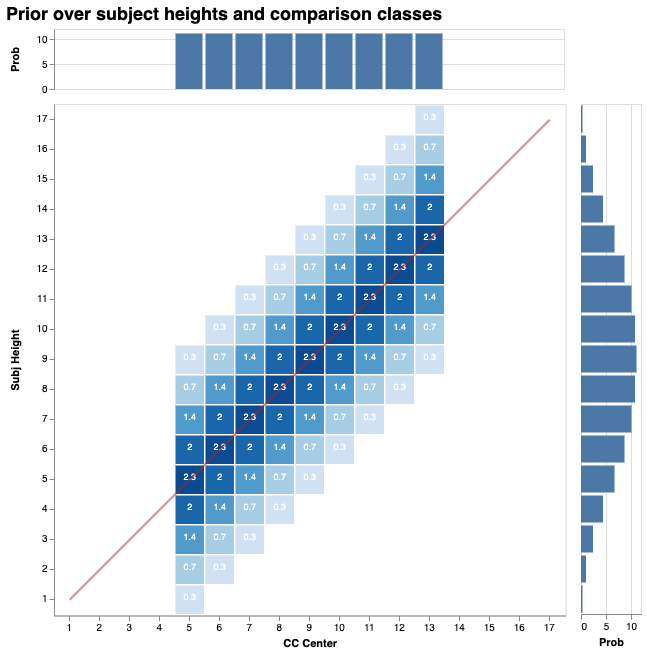

In [21]:
vlShow
  . addTitle "Prior over subject heights and comparison classes"
  . margHeatFromDist
  <$> enumD (first ht <$> indicesPriorFlat)

Experiments with explicit standards require a prior over the more refined universe in which the subject's height and the standard's height are independent and identically distributed

In [52]:
indicesPriorEq :: Model Index
indicesPriorEq =
  do (w,i) <- unif indicesEq
     observe (Normal 0 2.00) (fromIntegral $ ht w - i)
     observe (Normal 0 2.00) (fromIntegral $ std w - i)
     return (w,i)

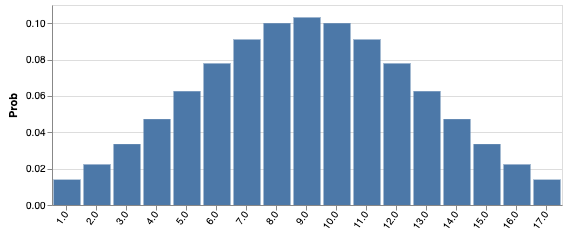

In [25]:
vlShow . barFromDist <$>  enumD (unif heights >>= \h -> observe (Normal 9 4.0) h >> return h)

Exogenous costs influence the prior likelihoods of utterances. We do not attempt to explain why one utterance is more marked than another. We assume only that there are differences. The actual values here are not particularly important, but the costliness rank matters.

In [22]:
cost, costUM :: Utt -> Double
cost = \case
  UNone -> 0
  UTall -> 1
  UShrt -> 2

costUM = \case
  UNone -> 1
  UTall -> 1
  UShrt -> 2

In [23]:
utterancePrior1 :: Model Utt
utterancePrior1 = belief . fromList $ [(u, - alpha * cost u) | u <- utterances]

Under the first setting of costs, a speaker will strongly prefer to say nothing. Under the second, saying nothing and using the unmarked message are equally likely. Under either setting, if forced to speak, will strongly prefer to use the unmarked utterance to the marked one

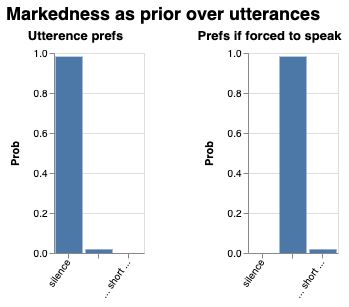

In [24]:
vlShow . addTitle "Markedness as prior over utterances" . sidewaysDists <$> sequence
  [ titled "Utterence prefs" . barFromDist <$> enumD utterancePrior1
  , titled "Prefs if forced to speak" . barFromDist <$>
      enumD (utterancePrior1 >>= \u -> condition (u /= UNone) >> return u)
  ]

In [25]:
utterancePriorNU = belief . fromList $ [(u, - alpha * cost u)   | u <- [UNone, UTall]]

{-
vlShow . addTitle "Markedness as prior over utterances" . sidewaysDists <$> sequence
  [ titled "Utterence prefs" . barFromDist <$> enumD utterancePriorNU
  , titled "Prefs if forced to speak" . barFromDist <$>
      enumD (utterancePriorNU >>= \u -> condition (u /= UNone) >> return u)
  ]
-}

utterancePriorNM = belief . fromList $ [(u, - alpha * cost u)   | u <- [UNone, UShrt]]

{-
vlShow . addTitle "Markedness as prior over utterances" . sidewaysDists <$> sequence
  [ titled "Utterence prefs" . barFromDist <$> enumD utterancePriorNM
  , titled "Prefs if forced to speak" . barFromDist <$>
      enumD (utterancePriorNM >>= \u -> condition (u /= UNone) >> return u)
  ]
-}
  
-- we can't ignore the null message entirely because the speaker always needs an
-- alternative of last resort in case the other messages are all false, so we
-- approximate by making the null message very very costly
utterancePriorUM = belief . fromList $ [(u, - alpha * costUM u) | u <- utterances]

{-
vlShow . addTitle "Markedness as prior over utterances" . sidewaysDists <$> sequence
  [ titled "Utterence prefs" . barFromDist <$> enumD utterancePriorUM
  , titled "Prefs if forced to speak" . barFromDist <$>
      enumD (utterancePriorUM >>= \u -> condition (u /= UNone) >> return u)
  , titled "Prefs if no marked" . barFromDist <$>
      enumD (utterancePriorUM >>= \u -> condition (u /= UShrt) >> return u)
  , titled "Prefs if no unmarked" . barFromDist <$>
      enumD (utterancePriorUM >>= \u -> condition (u /= UTall) >> return u)
  ]
-}

Default information state for experiments includes the prior over John's height and over positive, negative, and null utterance alternatives; the lexical prior is set for the particular construction under investigation

In [26]:
infoBaseline = Priors indicesPriorFlat utterancePrior1 undefined

Auxiliary function for plotting belief distributions:

In [27]:
-- display a joint distribution of subject heights and comparison class centers
-- after executing experiment m titled t, with threshold estimate at the end of m
mkGraph (t, m) = do
  heat <- enumD (first ht    . fst <$> m)
  thr  <- enumD (lexID       . snd <$> m)
  ecc <- enumD (ecc . fst <$> m)
  return $ toVegaLite
    [ center True
    , vConcat [ fromVL (margHeatFromDist heat)
              , asSpec [hConcat [ fromVL (sdBarFromDist htrange "Threshold" thr)
                                , fromVL (sdBarFromDist htrange "Subj. Ecc." ecc)
                                ]
                       ]
              ]
    , title (pack t) [TFontSize 18]
    ]

-- same as above, but also display derived standard eccentricity in addition to
-- subject eccentricity, for comparative, demonstrative, and equative experiments
mkStdGraph (t, m) = do
  heat <- enumD (first ht  . fst <$> m)
  thre <- enumD (lexID     . snd <$> m)
  jecc <- enumD (ecc       . fst <$> m)
  becc <- enumD (eccBy std . fst <$> m)
  return $ toVegaLite
    [ center True
    , vConcat [ fromVL (margHeatFromDist heat)
              , asSpec [hConcat [ fromVL (sdBarFromDist htrange "Threshold" thre)
                                , fromVL (sdBarFromDist htrange "Subj. Ecc." jecc)
                                , fromVL (sdBarFromDist htrange "Std. Ecc." becc)
                                ]
                       ]
              ]
    , title (pack t) [TFontSize 18]
    ]

## Positive Utterances

With these priors, we now model pragmatic listeners who consider various strengthenings of the assertion. Note that these are strengthenings in the dynamic sense of ruling out more "contexts" (here, comparison classes); the pure informational content about John's height is the same in all lexica.

Baseline `den0` lexicon interprets both antonyms as contextual tautologies (John's height is within 3 steps of the median)

On other interpretations, 'Tall' (resp. 'Short') places John in a certain upper (resp. lower) percentile of the comparison class

\begin{align}
[\![\text{John is tall}]\!]_{\sigma} &:= \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) \geq \mu + \sigma\\
[\![\text{John is short}]\!]_{\sigma} &:= \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) \leq \mu + \sigma
\end{align}

In [28]:
den0 :: Lexicon
den0 = Lex 0 f
  where f _ = indices

posDens :: [Lexicon]
posDens =
  do d <- htrange
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w <= i + d) indices
     return (Lex d f)

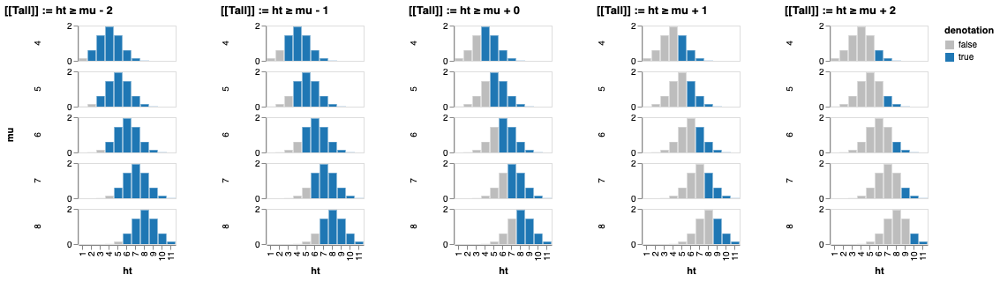

In [29]:
import IHaskell.Display (Display(..), javascript, vegalite)
import System.IO
readFile "posDens.vl" >>= \js -> pure (Display [vegalite js])

In [30]:
infoLUM = infoBaseline {lp = unif posDens}

#### Pragmatic listener hears:

> "John is tall"

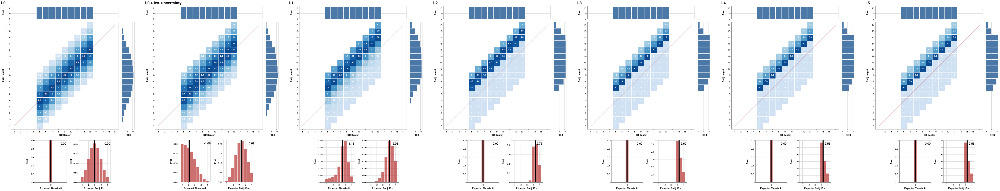

In [31]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUM cacheRef (0, UTall, den0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUM >>= \l -> listener infoLUM cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUM cacheRef (1, UTall, den0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUM cacheRef (2, UTall, den0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUM cacheRef (3, UTall, den0))
    
vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", listener infoLUM cacheRef (0, UTall, den0))
  , ("L0 + lex. uncertainty", lp infoLUM >>= \l -> listener infoLUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUM cacheRef (1, UTall, den0))
  , ("L2", listener infoLUM cacheRef (2, UTall, den0))
  , ("L3", listener infoLUM cacheRef (3, UTall, den0))
  , ("L4", listener infoLUM cacheRef (4, UTall, den0))
  , ("L5", listener infoLUM cacheRef (5, UTall, den0))
  ]

#### Pragmatic listener hears:

> "John is short"

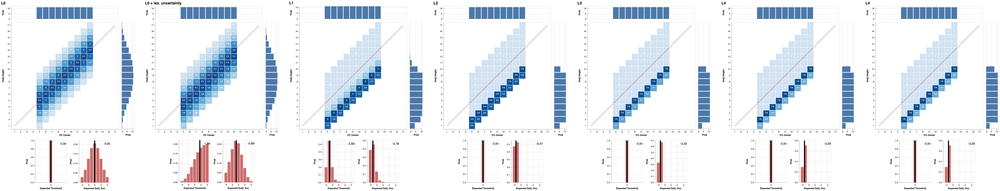

In [32]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUM cacheRef (0, UShrt, den0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUM >>= \l -> listener infoLUM cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUM cacheRef (1, UShrt, den0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUM cacheRef (2, UShrt, den0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUM cacheRef (3, UShrt, den0))
    
vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", listener infoLUM cacheRef (0, UShrt, den0))
  , ("L0 + lex. uncertainty", lp infoLUM >>= \l -> listener infoLUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUM cacheRef (1, UShrt, den0))
  , ("L2", listener infoLUM cacheRef (2, UShrt, den0))
  , ("L3", listener infoLUM cacheRef (3, UShrt, den0))
  , ("L4", listener infoLUM cacheRef (4, UShrt, den0))
  , ("L4", listener infoLUM cacheRef (5, UShrt, den0))
  ]

### Reduce competition with silence

With only antonyms competing, the positive construction exhibits exactly the behavior of the demonstrative,
showing that the exaggerated evaluativity displayed in the pos results is driven by competition
with silence

In [33]:
infoLUMUM = infoBaseline {up = utterancePriorUM, lp = unif posDens}

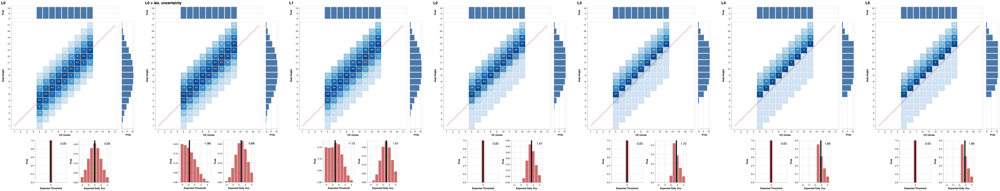

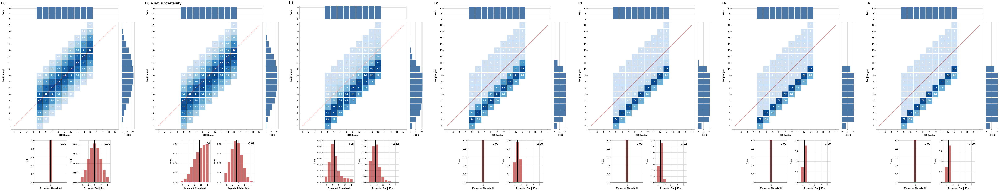

In [34]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMUM cacheRef (0, UTall, den0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMUM >>= \l -> listener infoLUMUM cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMUM cacheRef (1, UTall, den0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMUM cacheRef (2, UTall, den0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMUM cacheRef (3, UTall, den0))
    
vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", listener infoLUMUM cacheRef (0, UTall, den0))
  , ("L0 + lex. uncertainty", lp infoLUMUM >>= \l -> listener infoLUMUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMUM cacheRef (1, UTall, den0))
  , ("L2", listener infoLUMUM cacheRef (2, UTall, den0))
  , ("L3", listener infoLUMUM cacheRef (3, UTall, den0))
  , ("L4", listener infoLUMUM cacheRef (4, UTall, den0))
  , ("L5", listener infoLUMUM cacheRef (5, UTall, den0))
  ]
  
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMUM cacheRef (0, UShrt, den0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMUM >>= \l -> listener infoLUMUM cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMUM cacheRef (1, UShrt, den0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMUM cacheRef (2, UShrt, den0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMUM cacheRef (3, UShrt, den0))
    
vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", listener infoLUMUM cacheRef (0, UShrt, den0))
  , ("L0 + lex. uncertainty", lp infoLUMUM >>= \l -> listener infoLUMUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMUM cacheRef (1, UShrt, den0))
  , ("L2", listener infoLUMUM cacheRef (2, UShrt, den0))
  , ("L3", listener infoLUMUM cacheRef (3, UShrt, den0))
  , ("L4", listener infoLUMUM cacheRef (4, UShrt, den0))
  , ("L4", listener infoLUMUM cacheRef (5, UShrt, den0))
  ]

## Certain-Standard Exact Equative

All adjectival utterances are now interpreted as entailing that the John's height is the same as the standard's, which is known to be the midpoint of the height range; there's nothing special about the midpoint here, but it guarantees that inference about the comparison class is unconstrained by artificial boundaries above and below

In the baseline lexicon `denExact0`, this is all that is contributed by an utterance

Other interpretations place John's height at the midpoint and additionally guarantee that John's height is within a certain upper/lower percentile of the comparison class

\begin{equation}[\![\text{John is exactly as tall as Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) = b \land b \geq \mu + \sigma\end{equation}

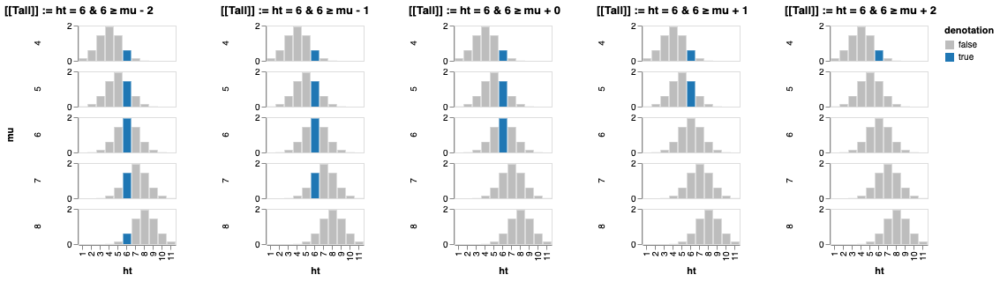

In [35]:
readFile "exactDens.vl" >>= \js -> pure (Display [vegalite js])

In [36]:
denExact0 = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w == std w) indices
        f UShrt = filter (\(w,i) -> ht w == std w) indices

exactDens :: [Lexicon]
exactDens = 
  do d <- htrange
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w == std w && std w >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w == std w && std w <= i + d) indices
     return (Lex d f)

#### Pragmatic listener hears

> "Bill's height is [midpoint]; John is exactly as tall as Bill"

In [37]:
infoLUMExact = infoBaseline {lp = unif exactDens}

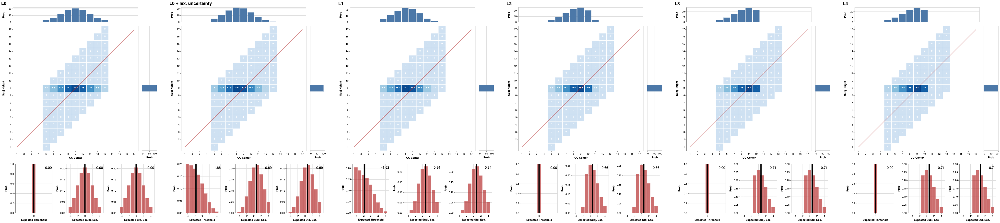

In [38]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMExact cacheRef (0, UTall, denExact0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExact >>= \l -> listener infoLUMExact cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExact cacheRef (1, UTall, denExact0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExact cacheRef (2, UTall, denExact0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExact cacheRef (3, UTall, denExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExact cacheRef (0, UTall, denExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExact >>= \l -> listener infoLUMExact cacheRef (0, UTall, l))
  , ("L1", listener infoLUMExact cacheRef (1, UTall, denExact0))
  , ("L2", listener infoLUMExact cacheRef (2, UTall, denExact0))
  , ("L3", listener infoLUMExact cacheRef (3, UTall, denExact0))
  , ("L4", listener infoLUMExact cacheRef (4, UTall, denExact0))
  ]

#### Pragmatic listener hears:

> "Bill's height is [midpoint]; John is exactly as short as Bill"

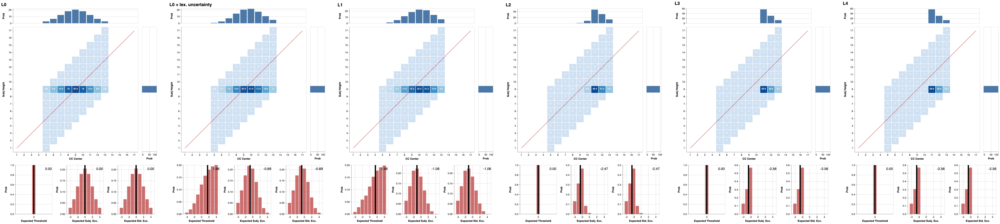

In [39]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMExact cacheRef (0, UShrt, denExact0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExact >>= \l -> listener infoLUMExact cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExact cacheRef (1, UShrt, denExact0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExact cacheRef (2, UShrt, denExact0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExact cacheRef (3, UShrt, denExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExact cacheRef (0, UShrt, denExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExact>>= \l -> listener infoLUMExact cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExact cacheRef (1, UShrt, denExact0))
  , ("L2", listener infoLUMExact cacheRef (2, UShrt, denExact0))
  , ("L3", listener infoLUMExact cacheRef (3, UShrt, denExact0))
  , ("L4", listener infoLUMExact cacheRef (4, UShrt, denExact0))
  ]

### Reduced competition with silence

No difference; all the markedness-driven effects were coming from competition between antonyms, not silence

In [40]:
infoLUMExactUM = infoBaseline {up = utterancePriorUM, lp = unif exactDens}

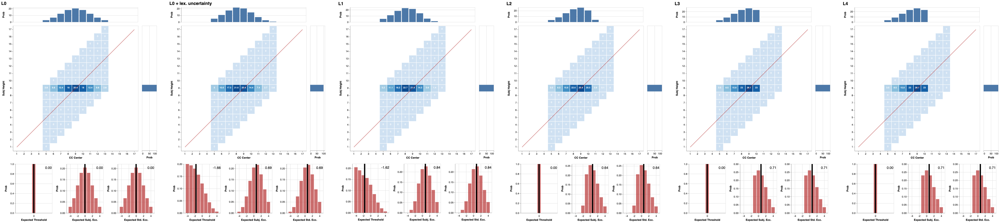

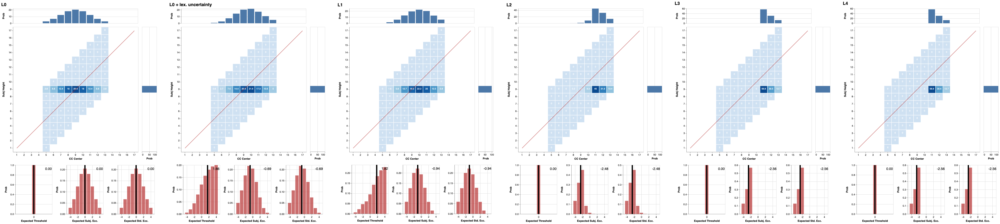

In [41]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkStdGraph ("L0 literal listener", listener infoLUMExactUM cacheRef (0, UTall, denExact0))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMExactUM >>= \l -> listener infoLUMExactUM cacheRef (0, UTall, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMExactUM cacheRef (1, UTall, denExact0))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMExactUM cacheRef (2, UTall, denExact0))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMExactUM cacheRef (3, UTall, denExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExactUM cacheRef (0, UTall, denExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExactUM >>= \l -> listener infoLUMExactUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMExactUM cacheRef (1, UTall, denExact0))
  , ("L2", listener infoLUMExactUM cacheRef (2, UTall, denExact0))
  , ("L3", listener infoLUMExactUM cacheRef (3, UTall, denExact0))
  , ("L4", listener infoLUMExactUM cacheRef (4, UTall, denExact0))
  ]
  
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkStdGraph ("L0 literal listener", listener infoLUMExactUM cacheRef (0, UShrt, denExact0))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMExactUM >>= \l -> listener infoLUMExactUM cacheRef (0, UShrt, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMExactUM cacheRef (1, UShrt, denExact0))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMExactUM cacheRef (2, UShrt, denExact0))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMExactUM cacheRef (3, UShrt, denExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExactUM cacheRef (0, UShrt, denExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExactUM >>= \l -> listener infoLUMExactUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExactUM cacheRef (1, UShrt, denExact0))
  , ("L2", listener infoLUMExactUM cacheRef (2, UShrt, denExact0))
  , ("L3", listener infoLUMExactUM cacheRef (3, UShrt, denExact0))
  , ("L4", listener infoLUMExactUM cacheRef (4, UShrt, denExact0))
  ]

### Take the unmarked utterance out of the equation

In [42]:
infoLUMExactNM = infoBaseline {up = utterancePriorNM, lp = unif exactDens}

The marked utterance now behaves just like the unmarked one does in the full competition,
showing that the unmarked form was only ever being pushed around by competition with silence,
while the marked form is being pushed around by the unmarked form

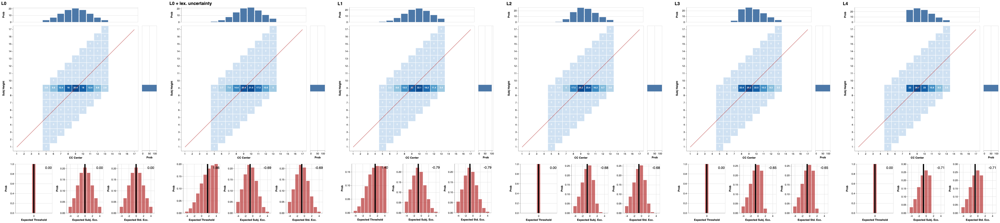

In [43]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkStdGraph ("L0 literal listener", listener infoLUMExactNM cacheRef (0, UShrt, denExact0))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMExactNM >>= \l -> listener infoLUMExactNM cacheRef (0, UShrt, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMExactNM cacheRef (1, UShrt, denExact0))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMExactNM cacheRef (2, UShrt, denExact0))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMExactNM cacheRef (3, UShrt, denExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExactNM cacheRef (0, UShrt, denExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExactNM >>= \l -> listener infoLUMExactNM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExactNM cacheRef (1, UShrt, denExact0))
  , ("L2", listener infoLUMExactNM cacheRef (2, UShrt, denExact0))
  , ("L3", listener infoLUMExactNM cacheRef (3, UShrt, denExact0))
  , ("L4", listener infoLUMExactNM cacheRef (4, UShrt, denExact0))
  ]

## Joint-Subject-Standard Exact Equative

Same semantics as in the certain-subject equative above --- subject's height is the same as the standard's --- but now the standard's height is unkown. For this experiment, both the standard and the subject are assumed to lie in the same comparison class, so it's most likely _a priori_ that they are close to the center, whatever it is

\begin{equation}[\![\text{John is exactly as tall as Bill}]\!]_{b,\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) = b \land b \geq \mu + \sigma\end{equation}
\begin{equation}[\![\text{John is exactly as short as Bill}]\!]_{b,\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) = b \land b \leq \mu + \sigma\end{equation}

In [50]:
denEq0 _ = Lex 0 f
  where f UNone = indicesEq
        f UTall = filter (\(w,i) -> ht w == std w) indicesEq
        f UShrt = filter (\(w,i) -> ht w == std w) indicesEq
        
eqDens :: [Lexicon]
eqDens = 
  do d <- htrange
     let f UNone = indicesEq
         f UTall = filter (\(w,i) -> ht w == std w && std w >= i + d) indicesEq
         f UShrt = filter (\(w,i) -> ht w == std w && std w <= i + d) indicesEq
     return (Lex d f)

#### Pragmatic listener hears

> "John is as tall as Bill"

Consider a listener that is not settled on one of these stengthenings

In [53]:
infoLUMEq = infoBaseline {ip = indicesPriorEq, lp = unif eqDens}

Because Bill's height is unknown, the literal (and pragmatic) posterior over worlds is spread out

The various conceivable interpretations lead ultimately to a pragmatic conclusion that John is probably above the median, though not by much.

As before, we see a relatively weak evaluativity effect

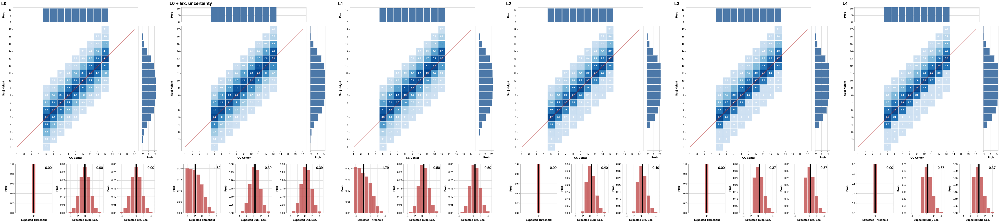

In [54]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMEq cacheRef (0, UTall, denEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMEq >>= \l -> listener infoLUMEq cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMEq cacheRef (1, UTall, denEq0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMEq cacheRef (2, UTall, denEq0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMEq cacheRef (3, UTall, denEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMEq cacheRef (0, UTall, denEq0 n))
  [ ("L0", listener infoLUMEq cacheRef (0, UTall, denEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMEq >>= \l -> listener infoLUMEq cacheRef (0, UTall, l))
  , ("L1", listener infoLUMEq cacheRef (1, UTall, denEq0 midpoint))
  , ("L2", listener infoLUMEq cacheRef (2, UTall, denEq0 midpoint))
  , ("L3", listener infoLUMEq cacheRef (3, UTall, denEq0 midpoint))
  , ("L4", listener infoLUMEq cacheRef (4, UTall, denEq0 midpoint))
  ]

#### Pragmatic listener hears:

> "John is as short as Bill"

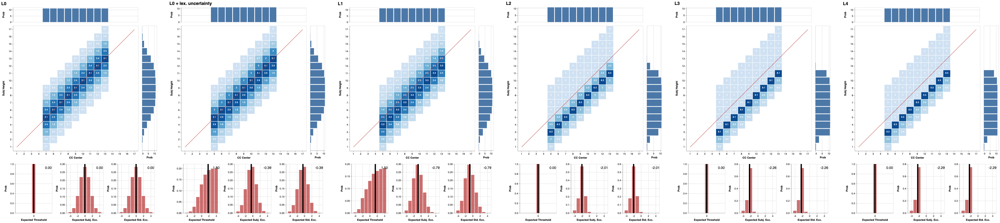

In [55]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMEq cacheRef (0, UShrt, denEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMEq >>= \l -> listener infoLUMEq cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMEq cacheRef (1, UShrt, denEq0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMEq cacheRef (2, UShrt, denEq0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMEq cacheRef (3, UShrt, denEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMEq cacheRef (0, UShrt, denEq0 n))
  [ ("L0", listener infoLUMEq cacheRef (0, UShrt, denEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMEq >>= \l -> listener infoLUMEq cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMEq cacheRef (1, UShrt, denEq0 midpoint))
  , ("L2", listener infoLUMEq cacheRef (2, UShrt, denEq0 midpoint))
  , ("L3", listener infoLUMEq cacheRef (3, UShrt, denEq0 midpoint))
  , ("L4", listener infoLUMEq cacheRef (4, UShrt, denEq0 midpoint))
  ]

### Reduced competition with silence

No difference; all the markedness-driven effects were coming from competition between antonyms, not silence

In [56]:
infoLUMEqUM = infoBaseline {ip = indicesPriorEq, up = utterancePriorUM, lp = unif eqDens}

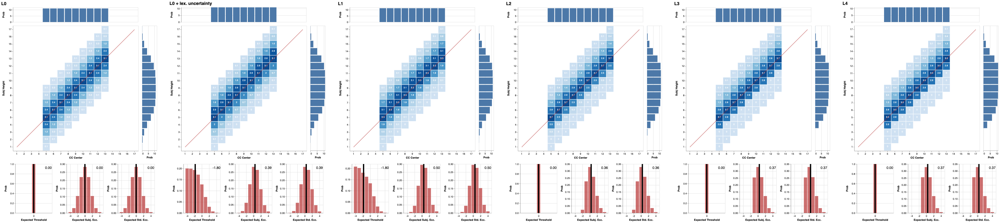

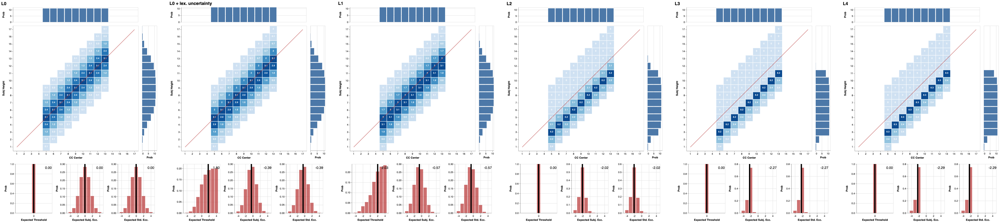

In [57]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkStdGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMEqUM cacheRef (0, UTall, denEq0 n))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMEqUM >>= \l -> listener infoLUMEqUM cacheRef (0, UTall, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMEqUM cacheRef (1, UTall, denEq0 midpoint))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMEqUM cacheRef (2, UTall, denEq0 midpoint))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMEqUM cacheRef (3, UTall, denEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMEqUM cacheRef (0, UTall, denEq0 n))
  [ ("L0", listener infoLUMEqUM cacheRef (0, UTall, denEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMEqUM >>= \l -> listener infoLUMEqUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMEqUM cacheRef (1, UTall, denEq0 midpoint))
  , ("L2", listener infoLUMEqUM cacheRef (2, UTall, denEq0 midpoint))
  , ("L3", listener infoLUMEqUM cacheRef (3, UTall, denEq0 midpoint))
  , ("L4", listener infoLUMEqUM cacheRef (4, UTall, denEq0 midpoint))
  ]

writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkStdGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMEqUM cacheRef (0, UShrt, denEq0 n))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMEqUM >>= \l -> listener infoLUMEqUM cacheRef (0, UShrt, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMEqUM cacheRef (1, UShrt, denEq0 midpoint))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMEqUM cacheRef (2, UShrt, denEq0 midpoint))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMEqUM cacheRef (3, UShrt, denEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMEqUM cacheRef (0, UShrt, denEq0 n))
  [ ("L0", listener infoLUMEqUM cacheRef (0, UShrt, denEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMEqUM >>= \l -> listener infoLUMEqUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMEqUM cacheRef (1, UShrt, denEq0 midpoint))
  , ("L2", listener infoLUMEqUM cacheRef (2, UShrt, denEq0 midpoint))
  , ("L3", listener infoLUMEqUM cacheRef (3, UShrt, denEq0 midpoint))
  , ("L4", listener infoLUMEqUM cacheRef (4, UShrt, denEq0 midpoint))
  ]

## Independent-Standard Exact Equative

Again the subject and standard are taken to have the same height, but now the prior over the standard is **uniformly distributed** from the entire range of possible heights. Not really sure this experiment makes any sense.

In [29]:
denIEq0 billht = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w == billht) indices
        f UShrt = filter (\(w,i) -> ht w == billht) indices

htsbill = [h | h <- heights, h > sigma, h <= maximum heights - sigma]
-- htsbill = heights

ieqDens :: [Lexicon]
ieqDens = 
  do d <- htrange
     b <- htsbill
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w == b && b >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w == b && b <= i + d) indices
     return (Lex (d * 25 + b) f)

#### Pragmatic listener hears

> "John is as exactly as tall as Bill"

In [30]:
infoLUMIEq = infoBaseline {lp = unif ieqDens}

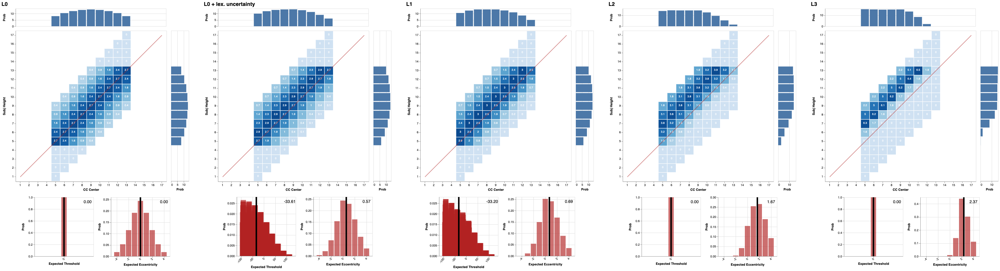

In [31]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMIEq cacheRef (0, UTall, denIEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMIEq >>= \l -> listener infoLUMIEq cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMIEq cacheRef (1, UTall, denIEq0 11))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMIEq cacheRef (2, UTall, denIEq0 11))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMIEq cacheRef (3, UTall, denIEq0 11))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> listener infoLUMIEq cacheRef (0, UTall, denIEq0 n))
  , ("L0 + lex. uncertainty", lp infoLUMIEq >>= \l -> listener infoLUMIEq cacheRef (0, UTall, l))
  , ("L1", listener infoLUMIEq cacheRef (1, UTall, denIEq0 11))
  , ("L2", listener infoLUMIEq cacheRef (2, UTall, denIEq0 11))
  , ("L3", listener infoLUMIEq cacheRef (3, UTall, denIEq0 11))
  ]

#### Pragmatic listener hears:

> "John is exactly as short as Bill"

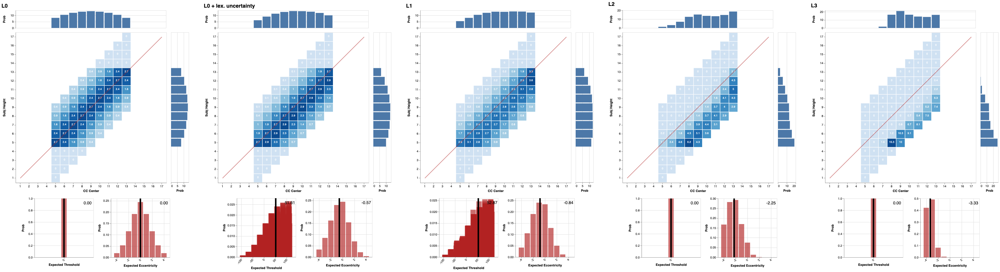

In [32]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMIEq cacheRef (0, UShrt, denIEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMIEq >>= \l -> listener infoLUMIEq cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMIEq cacheRef (1, UShrt, denIEq0 11))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMIEq cacheRef (2, UShrt, denIEq0 11))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMIEq cacheRef (3, UShrt, denIEq0 11))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> listener infoLUMIEq cacheRef (0, UShrt, denIEq0 n))
  , ("L0 + lex. uncertainty", lp infoLUMIEq >>= \l -> listener infoLUMIEq cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMIEq cacheRef (1, UShrt, denIEq0 11))
  , ("L2", listener infoLUMIEq cacheRef (2, UShrt, denIEq0 11))
  , ("L3", listener infoLUMIEq cacheRef (3, UShrt, denIEq0 11))
  ]

## Averaged-Standard Exact Equative

Same as the independent-standard exact equative above, but now the standard's height is drawn from a quasi-normal distribution over the range of possible heights (the marginal prior across all settings of the comparison class). Still not sure about the sensibility of this, since it assumes the standard's height is independent of the comparison class, unlike the subject.

In [33]:
denAEq0 billht = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w == billht) indices
        f UShrt = filter (\(w,i) -> ht w == billht) indices

-- htsbill = [4 .. 8]
htsbill = heights

aeqDens :: [Lexicon]
aeqDens = 
  do d <- htrange
     b <- htsbill
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w == b && b >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w == b && b <= i + d) indices
     return (Lex (d * 25 + b) f)

#### Pragmatic listener hears

> "John is exactly as tall as Bill"

In [34]:
aeqDenPrior = do
  l <- unif aeqDens
  let b = lexID l - maximum [d | d <- fmap (*25) htrange, d < lexID l]
  observe (Normal 9 4.0) (fromIntegral b)
  return l
  
infoLUMAEq = infoBaseline {lp = aeqDenPrior}

-- vlShow . barFromDist <$> enumD (lexID <$> aeqDenPrior)

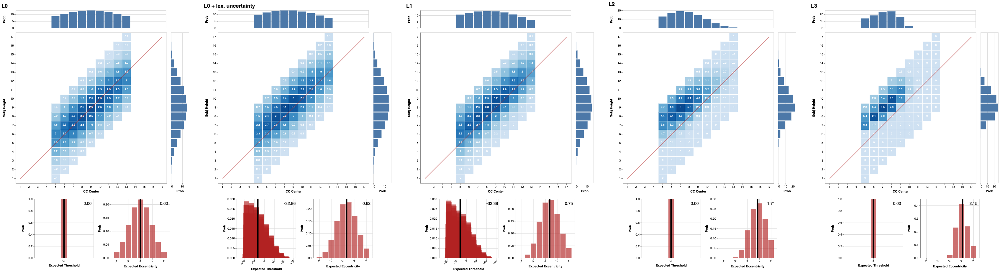

In [35]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMAEq cacheRef (0, UTall, denAEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMAEq >>= \l -> listener infoLUMAEq cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMAEq cacheRef (1, UTall, denAEq0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMAEq cacheRef (2, UTall, denAEq0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMAEq cacheRef (3, UTall, denAEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> observe (Normal 9 4.0) (fromIntegral n) >> listener infoLUMAEq cacheRef (0, UTall, denAEq0 n))
  , ("L0 + lex. uncertainty", lp infoLUMAEq >>= \l -> listener infoLUMAEq cacheRef (0, UTall, l))
  , ("L1", listener infoLUMAEq cacheRef (1, UTall, denAEq0 midpoint))
  , ("L2", listener infoLUMAEq cacheRef (2, UTall, denAEq0 midpoint))
  , ("L3", listener infoLUMAEq cacheRef (3, UTall, denAEq0 midpoint))
  ]

#### Pragmatic listener hears:

> "John is exactly as short as Bill"

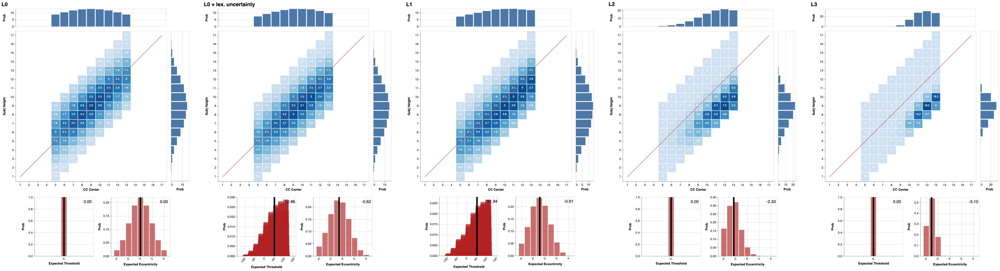

In [36]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMAEq cacheRef (0, UShrt, denAEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMAEq >>= \l -> listener infoLUMAEq cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMAEq cacheRef (1, UShrt, denAEq0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMAEq cacheRef (2, UShrt, denAEq0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMAEq cacheRef (3, UShrt, denAEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> observe (Normal 9 4.0) (fromIntegral n) >> listener infoLUMAEq cacheRef (0, UShrt, denAEq0 n))
  , ("L0 + lex. uncertainty", lp infoLUMAEq >>= \l -> listener infoLUMAEq cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMAEq cacheRef (1, UShrt, denAEq0 midpoint))
  , ("L2", listener infoLUMAEq cacheRef (2, UShrt, denAEq0 midpoint))
  , ("L3", listener infoLUMAEq cacheRef (3, UShrt, denAEq0 midpoint))
  ]

## Certain-Standard At-Least Equative 

Utterances are interpreted as entailing that the John's height is **more extreme** than the standard's height (the midpoint by assumption); at least as high for 'tall', at most as high for 'short'

In the baseline lexicon `denExtExact0`, this is all that is contributed by an utterance

Other interpretations place John's height above/below the midpoint and additionally guarantee that the standard is within a certain upper/lower percentile of the comparison class

\begin{equation}[\![\text{John is at least as tall as Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) \geq b \land b \geq \mu + \sigma\end{equation}
\begin{equation}[\![\text{John is at least as short as Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) \leq b \land b \leq \mu + \sigma\end{equation}

In [44]:
denExtExact0 = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w >= std w) indices
        f UShrt = filter (\(w,i) -> ht w <= std w) indices

extExactDens :: [Lexicon]
extExactDens = 
  do d <- htrange
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w >= std w && std w >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w <= std w && std w <= i + d) indices
     return (Lex d f)

#### Pragmatic listener hears

> "Bill's height is [midpoint]; John is at least as tall as Bill"

In [45]:
infoLUMExtExact = infoBaseline {lp = unif extExactDens}

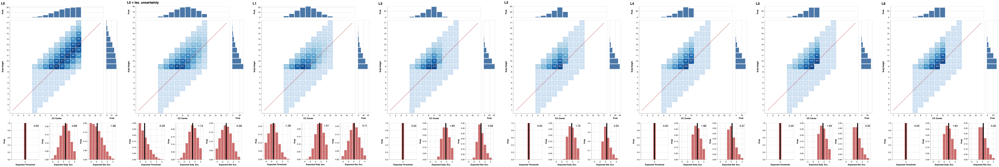

In [46]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMExtExact cacheRef (0, UTall, denExtExact0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExtExact >>= \l -> listener infoLUMExtExact cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExtExact cacheRef (1, UTall, denExtExact0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExtExact cacheRef (2, UTall, denExtExact0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExtExact cacheRef (3, UTall, denExtExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExtExact cacheRef (0, UTall, denExtExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExtExact >>= \l -> listener infoLUMExtExact cacheRef (0, UTall, l))
  , ("L1", listener infoLUMExtExact cacheRef (1, UTall, denExtExact0))
  , ("L2", listener infoLUMExtExact cacheRef (2, UTall, denExtExact0))
  , ("L3", listener infoLUMExtExact cacheRef (3, UTall, denExtExact0))
  , ("L4", listener infoLUMExtExact cacheRef (4, UTall, denExtExact0))
  , ("L5", listener infoLUMExtExact cacheRef (5, UTall, denExtExact0))
  , ("L6", listener infoLUMExtExact cacheRef (6, UTall, denExtExact0))
  ]

#### Pragmatic listener hears:

> "Bill's height is [midpoint]; John is at least as short as Bill"

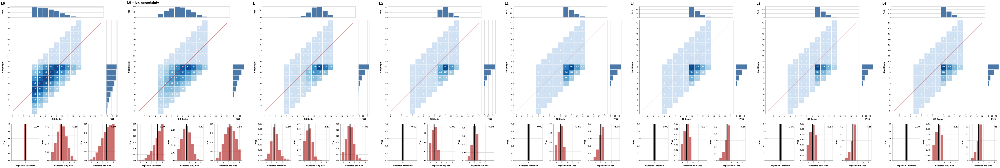

In [47]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMExtExact cacheRef (0, UShrt, denExtExact0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExtExact >>= \l -> listener infoLUMExtExact cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExtExact cacheRef (1, UShrt, denExtExact0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExtExact cacheRef (2, UShrt, denExtExact0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExtExact cacheRef (3, UShrt, denExtExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExtExact cacheRef (0, UShrt, denExtExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExtExact>>= \l -> listener infoLUMExtExact cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExtExact cacheRef (1, UShrt, denExtExact0))
  , ("L2", listener infoLUMExtExact cacheRef (2, UShrt, denExtExact0))
  , ("L3", listener infoLUMExtExact cacheRef (3, UShrt, denExtExact0))
  , ("L4", listener infoLUMExtExact cacheRef (4, UShrt, denExtExact0))
  , ("L5", listener infoLUMExtExact cacheRef (5, UShrt, denExtExact0))
  , ("L6", listener infoLUMExtExact cacheRef (6, UShrt, denExtExact0))
  ]

### Reduced competition with silence

No difference; all the markedness-driven effects were coming from competition between antonyms, not silence

In [48]:
infoLUMExtExactUM = infoBaseline {up = utterancePriorUM, lp = unif extExactDens}

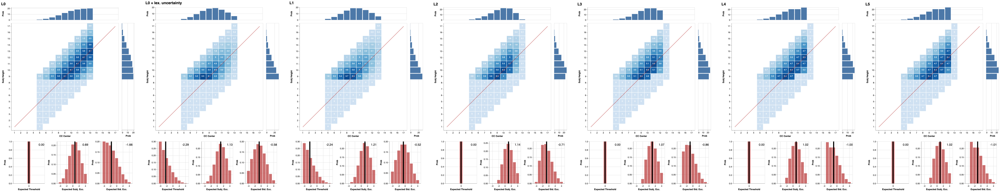

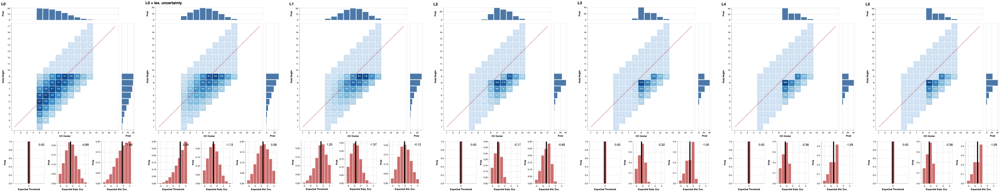

In [49]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMExtExactUM cacheRef (0, UTall, denExtExact0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExtExactUM >>= \l -> listener infoLUMExtExactUM cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExtExactUM cacheRef (1, UTall, denExtExact0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExtExactUM cacheRef (2, UTall, denExtExact0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExtExactUM cacheRef (3, UTall, denExtExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExtExactUM cacheRef (0, UTall, denExtExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExtExactUM >>= \l -> listener infoLUMExtExactUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMExtExactUM cacheRef (1, UTall, denExtExact0))
  , ("L2", listener infoLUMExtExactUM cacheRef (2, UTall, denExtExact0))
  , ("L3", listener infoLUMExtExactUM cacheRef (3, UTall, denExtExact0))
  , ("L4", listener infoLUMExtExactUM cacheRef (4, UTall, denExtExact0))
  , ("L5", listener infoLUMExtExactUM cacheRef (5, UTall, denExtExact0))
  ]
  
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMExtExactUM cacheRef (0, UShrt, denExtExact0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExtExactUM >>= \l -> listener infoLUMExtExactUM cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExtExactUM cacheRef (1, UShrt, denExtExact0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExtExactUM cacheRef (2, UShrt, denExtExact0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExtExactUM cacheRef (3, UShrt, denExtExact0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMExtExactUM cacheRef (0, UShrt, denExtExact0))
  , ("L0 + lex. uncertainty", lp infoLUMExtExactUM >>= \l -> listener infoLUMExtExactUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExtExactUM cacheRef (1, UShrt, denExtExact0))
  , ("L2", listener infoLUMExtExactUM cacheRef (2, UShrt, denExtExact0))
  , ("L3", listener infoLUMExtExactUM cacheRef (3, UShrt, denExtExact0))
  , ("L4", listener infoLUMExtExactUM cacheRef (4, UShrt, denExtExact0))
  , ("L5", listener infoLUMExtExactUM cacheRef (5, UShrt, denExtExact0))
  ]

## Joint-Subject-Standard At-Least Equative

Same semantics as the certain-standard at-least equative above, but now the standard's height is unknown. Here it is assumed to be drawn from the same comparison class as the subject.

\begin{equation}[\![\text{John is at least as tall as Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) \geq b \land b \geq \mu + \sigma\end{equation}
\begin{equation}[\![\text{John is at least as short as Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) \leq b \land b \leq \mu + \sigma\end{equation}

In [58]:
denExtEq0 _ = Lex 0 f
  where f UNone = indicesEq
        f UTall = filter (\(w,i) -> ht w >= std w) indicesEq
        f UShrt = filter (\(w,i) -> ht w <= std w) indicesEq
        
extEqDens :: [Lexicon]
extEqDens = 
  do d <- htrange
     let f UNone = indicesEq
         f UTall = filter (\(w,i) -> ht w >= std w && std w >= i + d) indicesEq
         f UShrt = filter (\(w,i) -> ht w <= std w && std w <= i + d) indicesEq
     return (Lex d f)

#### Pragmatic listener hears

> "John is at least as tall as Bill"

In [59]:
infoLUMExtEq = infoBaseline {ip = indicesPriorEq, lp = unif extEqDens}

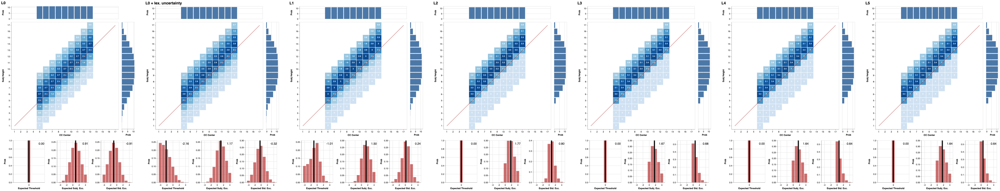

In [60]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMExtEq cacheRef (0, UTall, denExtEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExtEq >>= \l -> listener infoLUMExtEq cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExtEq cacheRef (1, UTall, denExtEq0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExtEq cacheRef (2, UTall, denExtEq0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExtEq cacheRef (3, UTall, denExtEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMExtEq cacheRef (0, UTall, denExtEq0 n))
  [ ("L0", listener infoLUMExtEq cacheRef (0, UTall, denExtEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMExtEq >>= \l -> listener infoLUMExtEq cacheRef (0, UTall, l))
  , ("L1", listener infoLUMExtEq cacheRef (1, UTall, denExtEq0 midpoint))
  , ("L2", listener infoLUMExtEq cacheRef (2, UTall, denExtEq0 midpoint))
  , ("L3", listener infoLUMExtEq cacheRef (3, UTall, denExtEq0 midpoint))
  , ("L4", listener infoLUMExtEq cacheRef (4, UTall, denExtEq0 midpoint))
  , ("L5", listener infoLUMExtEq cacheRef (5, UTall, denExtEq0 midpoint))
  ]

#### Pragmatic listener hears:

> "John is at least as short as Bill"

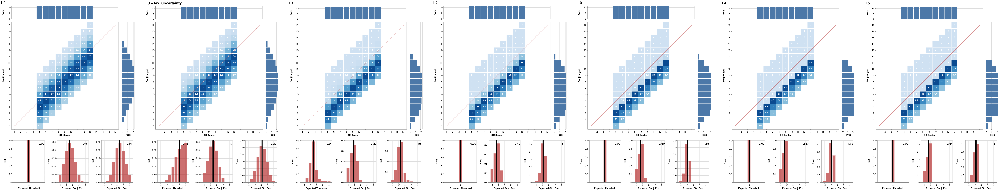

In [61]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMExtEq cacheRef (0, UShrt, denExtEq0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMExtEq >>= \l -> listener infoLUMExtEq cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMExtEq cacheRef (1, UShrt, denExtEq0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMExtEq cacheRef (2, UShrt, denExtEq0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMExtEq cacheRef (3, UShrt, denExtEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMExtEq cacheRef (0, UShrt, denExtEq0 n))
  [ ("L0", listener infoLUMExtEq cacheRef (0, UShrt, denExtEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMExtEq >>= \l -> listener infoLUMExtEq cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExtEq cacheRef (1, UShrt, denExtEq0 midpoint))
  , ("L2", listener infoLUMExtEq cacheRef (2, UShrt, denExtEq0 midpoint))
  , ("L3", listener infoLUMExtEq cacheRef (3, UShrt, denExtEq0 midpoint))
  , ("L4", listener infoLUMExtEq cacheRef (4, UShrt, denExtEq0 midpoint))
  , ("L5", listener infoLUMExtEq cacheRef (5, UShrt, denExtEq0 midpoint))
  ]

### Reduced competition with silence

No difference; all the markedness-driven effects were coming from competition between antonyms, not silence

In [62]:
infoLUMExtEqUM = infoBaseline {ip = indicesPriorEq, up = utterancePriorUM, lp = unif extEqDens}

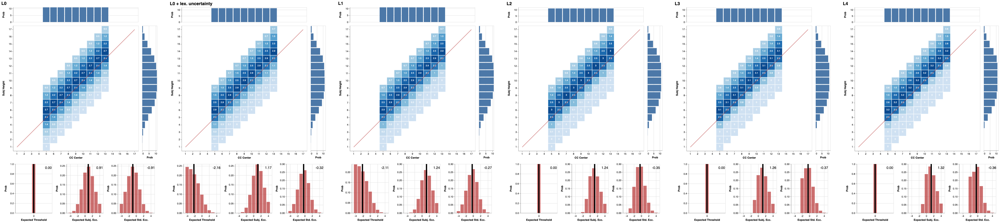

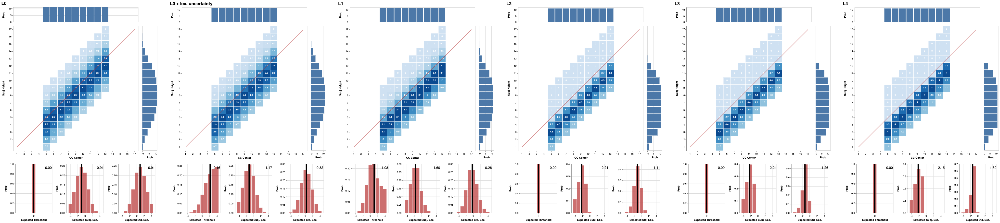

In [63]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkStdGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMExtEqUM cacheRef (0, UTall, denExtEq0 n))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMExtEqUM >>= \l -> listener infoLUMExtEqUM cacheRef (0, UTall, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMExtEqUM cacheRef (1, UTall, denExtEq0 midpoint))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMExtEqUM cacheRef (2, UTall, denExtEq0 midpoint))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMExtEqUM cacheRef (3, UTall, denExtEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMExtEqUM cacheRef (0, UTall, denExtEq0 n))
  [ ("L0", listener infoLUMExtEqUM cacheRef (0, UTall, denExtEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMExtEqUM >>= \l -> listener infoLUMExtEqUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMExtEqUM cacheRef (1, UTall, denExtEq0 midpoint))
  , ("L2", listener infoLUMExtEqUM cacheRef (2, UTall, denExtEq0 midpoint))
  , ("L3", listener infoLUMExtEqUM cacheRef (3, UTall, denExtEq0 midpoint))
  , ("L4", listener infoLUMExtEqUM cacheRef (4, UTall, denExtEq0 midpoint))
  ]

writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkStdGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMExtEqUM cacheRef (0, UShrt, denExtEq0 n))
-- vlShow <$> mkStdGraph ("L0 + lex. uncertainty", lp infoLUMExtEqUM >>= \l -> listener infoLUMExtEqUM cacheRef (0, UShrt, l))
-- vlShow <$> mkStdGraph ("L1 pragmatic listener", listener infoLUMExtEqUM cacheRef (1, UShrt, denExtEq0 midpoint))
-- vlShow <$> mkStdGraph ("L2 pragmatic listener", listener infoLUMExtEqUM cacheRef (2, UShrt, denExtEq0 midpoint))
-- vlShow <$> mkStdGraph ("L3 pragmatic listener", listener infoLUMExtEqUM cacheRef (3, UShrt, denExtEq0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMExtEqUM cacheRef (0, UShrt, denExtEq0 n))
  [ ("L0", listener infoLUMExtEqUM cacheRef (0, UShrt, denExtEq0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMExtEqUM >>= \l -> listener infoLUMExtEqUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMExtEqUM cacheRef (1, UShrt, denExtEq0 midpoint))
  , ("L2", listener infoLUMExtEqUM cacheRef (2, UShrt, denExtEq0 midpoint))
  , ("L3", listener infoLUMExtEqUM cacheRef (3, UShrt, denExtEq0 midpoint))
  , ("L4", listener infoLUMExtEqUM cacheRef (4, UShrt, denExtEq0 midpoint))
  ]

## Certain-Standard Comparative

Utterances interpreted as entailing that John's height is greater/lower than the standard's, which is known to be the midpoint

In the baseline lexicon `denKCmp`, this is all that is contributed by an utterance

Other interpretations place John's height above/below the standard's, and additionally guarantee that **the standard**'s height is within a certain upper/lower percentile of the comparison class

\begin{equation}[\![\text{John is taller than Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) > b \land b \geq \mu + \sigma\end{equation}
\begin{equation}[\![\text{John is shorter than Bill}]\!]_{\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) < b \land b \leq \mu + \sigma\end{equation}

In [64]:
denKCmp0 = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w > midpoint) indices
        f UShrt = filter (\(w,i) -> ht w < midpoint) indices

kcmpDens :: [Lexicon]
kcmpDens = 
  do d <- htrange
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w > midpoint && midpoint >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w < midpoint && midpoint <= i + d) indices
     return (Lex d f)

#### Pragmatic listener hears

> "Bill's height is [midpoint]; John is taller than Bill"

In [65]:
infoLUMKCmp = infoBaseline {lp = unif kcmpDens}

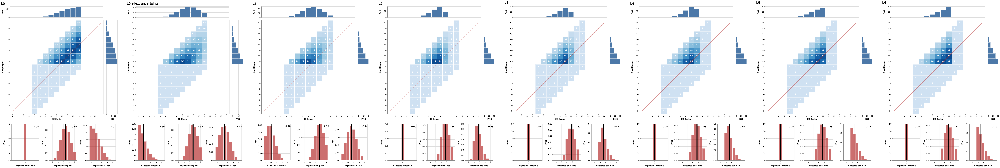

In [66]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMKCmp cacheRef (0, UTall, denKCmp0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMKCmp >>= \l -> listener infoLUMKCmp cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMKCmp cacheRef (1, UTall, denKCmp0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMKCmp cacheRef (2, UTall, denKCmp0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMKCmp cacheRef (3, UTall, denKCmp0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMKCmp cacheRef (0, UTall, denKCmp0))
  , ("L0 + lex. uncertainty", lp infoLUMKCmp >>= \l -> listener infoLUMKCmp cacheRef (0, UTall, l))
  , ("L1", listener infoLUMKCmp cacheRef (1, UTall, denKCmp0))
  , ("L2", listener infoLUMKCmp cacheRef (2, UTall, denKCmp0))
  , ("L3", listener infoLUMKCmp cacheRef (3, UTall, denKCmp0))
  , ("L4", listener infoLUMKCmp cacheRef (4, UTall, denKCmp0))
  , ("L5", listener infoLUMKCmp cacheRef (5, UTall, denKCmp0))
  , ("L6", listener infoLUMKCmp cacheRef (6, UTall, denKCmp0))
  ]

#### Pragmatic listener hears:

> "Bill's height is [midpoint]; John is shorter than Bill"

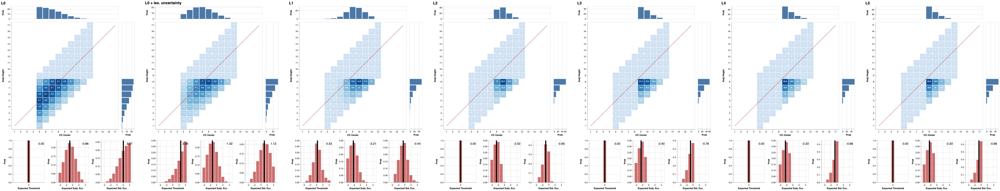

In [67]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMKCmp cacheRef (0, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMKCmp >>= \l -> listener infoLUMKCmp cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMKCmp cacheRef (1, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMKCmp cacheRef (2, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMKCmp cacheRef (3, UShrt, denKCmp0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMKCmp cacheRef (0, UShrt, denKCmp0))
  , ("L0 + lex. uncertainty", lp infoLUMKCmp >>= \l -> listener infoLUMKCmp cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMKCmp cacheRef (1, UShrt, denKCmp0))
  , ("L2", listener infoLUMKCmp cacheRef (2, UShrt, denKCmp0))
  , ("L3", listener infoLUMKCmp cacheRef (3, UShrt, denKCmp0))
  , ("L4", listener infoLUMKCmp cacheRef (4, UShrt, denKCmp0))
  , ("L5", listener infoLUMKCmp cacheRef (5, UShrt, denKCmp0))
  ]

### Reduced competition with silence

Because the two antonym utterances are entirely contradictory, making silence extremely costly effectively eliminates all competition. Consequently, pragmatic listeners just end up with literal interpretations (not sure what's going on with L1?)

In [68]:
infoLUMKCmpUM = infoBaseline {up = utterancePriorUM, lp = unif kcmpDens}

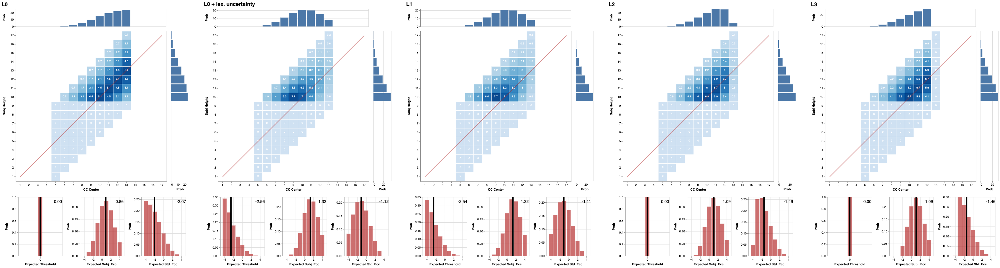

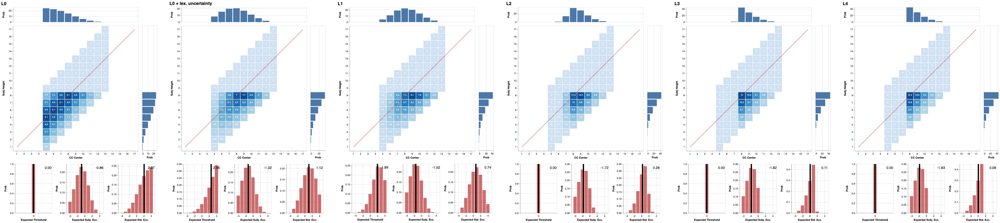

In [69]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMKCmpUM cacheRef (0, UTall, denKCmp0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMKCmpUM >>= \l -> listener infoLUMKCmpUM cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMKCmpUM cacheRef (1, UTall, denKCmp0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMKCmpUM cacheRef (2, UTall, denKCmp0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMKCmpUM cacheRef (3, UTall, denKCmp0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMKCmpUM cacheRef (0, UTall, denKCmp0))
  , ("L0 + lex. uncertainty", lp infoLUMKCmpUM >>= \l -> listener infoLUMKCmpUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMKCmpUM cacheRef (1, UTall, denKCmp0))
  , ("L2", listener infoLUMKCmpUM cacheRef (2, UTall, denKCmp0))
  , ("L3", listener infoLUMKCmpUM cacheRef (3, UTall, denKCmp0))
  ]
  
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMKCmpUM cacheRef (0, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMKCmpUM >>= \l -> listener infoLUMKCmpUM cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMKCmpUM cacheRef (1, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMKCmpUM cacheRef (2, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMKCmpUM cacheRef (3, UShrt, denKCmp0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMKCmpUM cacheRef (0, UShrt, denKCmp0))
  , ("L0 + lex. uncertainty", lp infoLUMKCmpUM >>= \l -> listener infoLUMKCmpUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMKCmpUM cacheRef (1, UShrt, denKCmp0))
  , ("L2", listener infoLUMKCmpUM cacheRef (2, UShrt, denKCmp0))
  , ("L3", listener infoLUMKCmpUM cacheRef (3, UShrt, denKCmp0))
  , ("L4", listener infoLUMKCmpUM cacheRef (4, UShrt, denKCmp0))
  ]

### Taking the unmarked form out of the equation

Again because the marked and unmarked forms are contradictory, the only competition for the marked form is with silence, so when the unmarked form is ignored, the results are the same as in the full model

In [70]:
infoLUMKCmpNM = infoBaseline {up = utterancePriorNM, lp = unif kcmpDens}

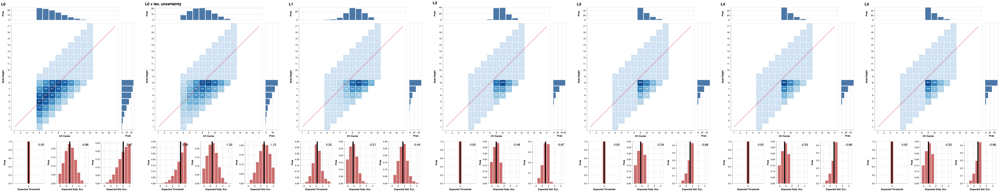

In [71]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", listener infoLUMKCmpNM cacheRef (0, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMKCmpNM >>= \l -> listener infoLUMKCmpNM cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMKCmpNM cacheRef (1, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMKCmpNM cacheRef (2, UShrt, denKCmp0))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMKCmpNM cacheRef (3, UShrt, denKCmp0))
    
vlShow . sidewaysDists <$> traverse mkStdGraph
  [ ("L0", listener infoLUMKCmpNM cacheRef (0, UShrt, denKCmp0))
  , ("L0 + lex. uncertainty", lp infoLUMKCmpNM >>= \l -> listener infoLUMKCmpNM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMKCmpNM cacheRef (1, UShrt, denKCmp0))
  , ("L2", listener infoLUMKCmpNM cacheRef (2, UShrt, denKCmp0))
  , ("L3", listener infoLUMKCmpNM cacheRef (3, UShrt, denKCmp0))
  , ("L4", listener infoLUMKCmpNM cacheRef (4, UShrt, denKCmp0))
  , ("L5", listener infoLUMKCmpNM cacheRef (5, UShrt, denKCmp0))
  ]

## Uncertain-Standard Comparative

Same semantics as the certain-standard comparative above, except that now the standard's height is uknown. For this experiment, it is assumed to be drawn from the same comparison class as the subject

As with the other uncertain-standard experiments, there is no real baseline here, since there is no privileged belief for Bill's height, so even the literal listener will have to average over guesses about Bill

Other interpretations place John's height at other values, and additionally guarantee that John's height is within a certain upper/lower percentile of the comparison class

\begin{equation}[\![\text{John is taller than Bill}]\!]_{b,\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) > b \land b \geq \mu + \sigma\end{equation}
\begin{equation}[\![\text{John is shorter than Bill}]\!]_{b,\sigma} := \lambda \langle w,\mu\rangle.\, \textsf{ht}_w(\textsf{j}) < b \land b \leq \mu + \sigma\end{equation}

In [72]:
denCmp0 _ = Lex 0 f
  where f UNone = indicesEq
        f UTall = filter (\(w,i) -> ht w > std w) indicesEq
        f UShrt = filter (\(w,i) -> ht w < std w) indicesEq
        
cmpDens :: [Lexicon]
cmpDens = 
  do d <- htrange
     let f UNone = indicesEq
         f UTall = filter (\(w,i) -> ht w > std w && std w >= i + d) indicesEq
         f UShrt = filter (\(w,i) -> ht w < std w && std w <= i + d) indicesEq
     return (Lex d f)

#### Pragmatic listener hears

> "John is taller than Bill"

In [73]:
infoLUMCmp = infoBaseline {ip = indicesPriorEq, lp = unif cmpDens}

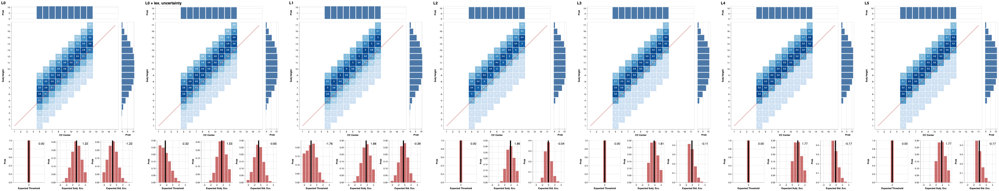

In [74]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMCmp cacheRef (0, UTall, denCmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMCmp >>= \l -> listener infoLUMCmp cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMCmp cacheRef (1, UTall, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMCmp cacheRef (2, UTall, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMCmp cacheRef (3, UTall, denCmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMCmp cacheRef (0, UTall, denCmp0 n))
  [ ("L0", listener infoLUMCmp cacheRef (0, UTall, denCmp0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMCmp >>= \l -> listener infoLUMCmp cacheRef (0, UTall, l))
  , ("L1", listener infoLUMCmp cacheRef (1, UTall, denCmp0 midpoint))
  , ("L2", listener infoLUMCmp cacheRef (2, UTall, denCmp0 midpoint))
  , ("L3", listener infoLUMCmp cacheRef (3, UTall, denCmp0 midpoint))
  , ("L4", listener infoLUMCmp cacheRef (4, UTall, denCmp0 midpoint))
  , ("L5", listener infoLUMCmp cacheRef (5, UTall, denCmp0 midpoint))
  ]

#### Pragmatic listener hears:

> "John is shorter than Bill"

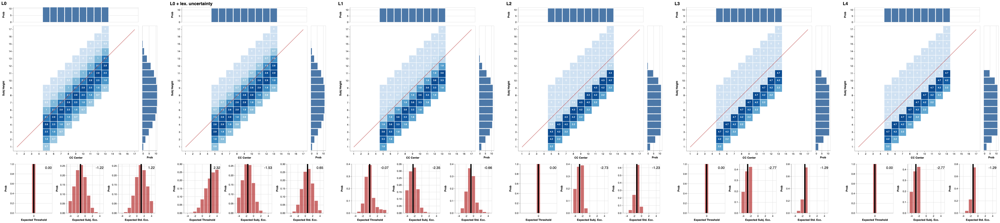

In [75]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMCmp cacheRef (0, UShrt, denCmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMCmp >>= \l -> listener infoLUMCmp cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMCmp cacheRef (1, UShrt, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMCmp cacheRef (2, UShrt, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMCmp cacheRef (3, UShrt, denCmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMCmp cacheRef (0, UShrt, denCmp0 n))
  [ ("L0", listener infoLUMCmp cacheRef (0, UShrt, denCmp0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMCmp >>= \l -> listener infoLUMCmp cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMCmp cacheRef (1, UShrt, denCmp0 midpoint))
  , ("L2", listener infoLUMCmp cacheRef (2, UShrt, denCmp0 midpoint))
  , ("L3", listener infoLUMCmp cacheRef (3, UShrt, denCmp0 midpoint))
  , ("L4", listener infoLUMCmp cacheRef (4, UShrt, denCmp0 midpoint))
  ]

### Reduced competition with silence

In [76]:
infoLUMCmpUM = infoBaseline {ip = indicesPriorEq, up = utterancePriorUM, lp = unif cmpDens}

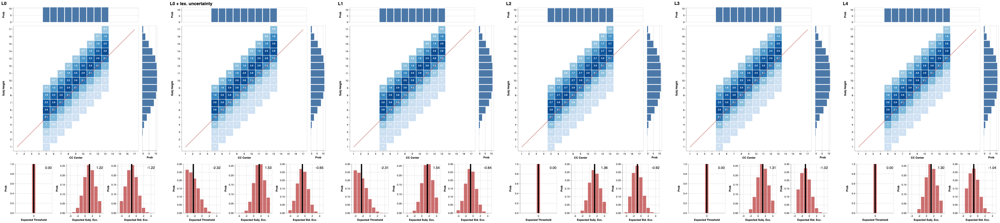

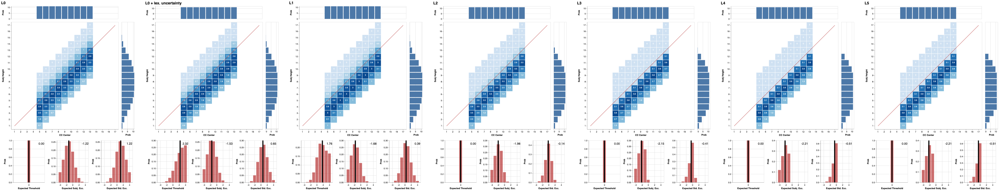

In [77]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMCmpUM cacheRef (0, UTall, denCmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMCmpUM >>= \l -> listener infoLUMCmpUM cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMCmpUM cacheRef (1, UTall, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMCmpUM cacheRef (2, UTall, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMCmpUM cacheRef (3, UTall, denCmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMCmpUM cacheRef (0, UTall, denCmp0 n))
  [ ("L0", listener infoLUMCmpUM cacheRef (0, UTall, denCmp0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMCmpUM >>= \l -> listener infoLUMCmpUM cacheRef (0, UTall, l))
  , ("L1", listener infoLUMCmpUM cacheRef (1, UTall, denCmp0 midpoint))
  , ("L2", listener infoLUMCmpUM cacheRef (2, UTall, denCmp0 midpoint))
  , ("L3", listener infoLUMCmpUM cacheRef (3, UTall, denCmp0 midpoint))
  , ("L4", listener infoLUMCmpUM cacheRef (4, UTall, denCmp0 midpoint))
  ]

writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMCmpUM cacheRef (0, UShrt, denCmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMCmpUM >>= \l -> listener infoLUMCmpUM cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMCmpUM cacheRef (1, UShrt, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMCmpUM cacheRef (2, UShrt, denCmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMCmpUM cacheRef (3, UShrt, denCmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkStdGraph
--   [ ("L0", unif htsbill >>= \n -> listener infoLUMCmpUM cacheRef (0, UShrt, denCmp0 n))
  [ ("L0", listener infoLUMCmpUM cacheRef (0, UShrt, denCmp0 midpoint))
  , ("L0 + lex. uncertainty", lp infoLUMCmpUM >>= \l -> listener infoLUMCmpUM cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMCmpUM cacheRef (1, UShrt, denCmp0 midpoint))
  , ("L2", listener infoLUMCmpUM cacheRef (2, UShrt, denCmp0 midpoint))
  , ("L3", listener infoLUMCmpUM cacheRef (3, UShrt, denCmp0 midpoint))
  , ("L4", listener infoLUMCmpUM cacheRef (4, UShrt, denCmp0 midpoint))
  , ("L5", listener infoLUMCmpUM cacheRef (5, UShrt, denCmp0 midpoint))
  ]

## Independent-Standard Comparative

Same as the uncertain-standard comparative above, but now the standard's height drawn uniformly from the entire range

In [76]:
denICmp0 billht = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w > billht) indices
        f UShrt = filter (\(w,i) -> ht w < billht) indices

htsbill = [h | h <- heights, h > sigma, h <= maximum heights - sigma]
-- htsbill = heights

icmpDens :: [Lexicon]
icmpDens = 
  do d <- htrange
     b <- htsbill
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w > b && b >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w < b && b <= i + d) indices
     return (Lex (d * 25 + b) f)

#### Pragmatic listener hears

> "John is taller than Bill"

In [77]:
infoLUMICmp = infoBaseline {lp = unif icmpDens}

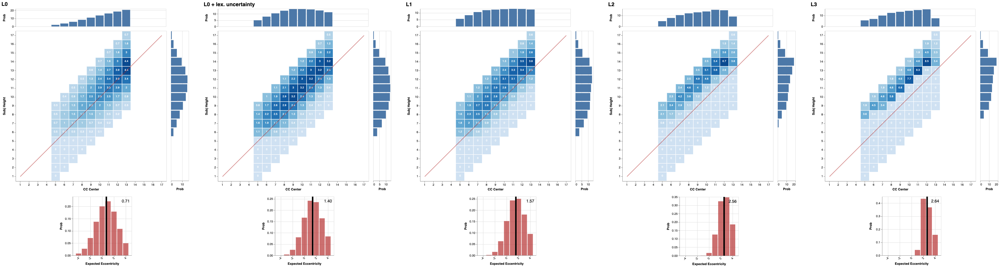

In [78]:
writeIORef cacheRef (0, Map.empty)
 
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMICmp cacheRef (0, UTall, denICmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMICmp >>= \l -> listener infoLUMICmp cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMICmp cacheRef (1, UTall, denICmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMICmp cacheRef (2, UTall, denICmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMICmp cacheRef (3, UTall, denICmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> listener infoLUMICmp cacheRef (0, UTall, denICmp0 n))
  , ("L0 + lex. uncertainty", lp infoLUMICmp >>= \l -> listener infoLUMICmp cacheRef (0, UTall, l))
  , ("L1", listener infoLUMICmp cacheRef (1, UTall, denICmp0 midpoint))
  , ("L2", listener infoLUMICmp cacheRef (2, UTall, denICmp0 midpoint))
  , ("L3", listener infoLUMICmp cacheRef (3, UTall, denICmp0 midpoint))
  ]

#### Pragmatic listener hears:

> "John is shorter than Bill"

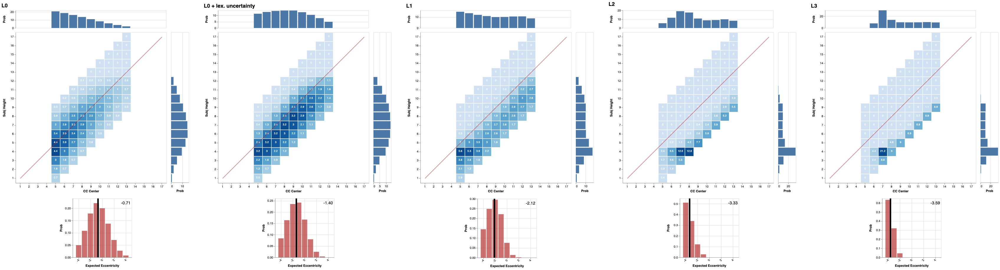

In [79]:
writeIORef cacheRef (0, Map.empty)

-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMICmp cacheRef (0, UShrt, denICmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMICmp >>= \l -> listener infoLUMICmp cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMICmp cacheRef (1, UShrt, denICmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMICmp cacheRef (2, UShrt, denICmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMICmp cacheRef (3, UShrt, denICmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> listener infoLUMICmp cacheRef (0, UShrt, denICmp0 n))
  , ("L0 + lex. uncertainty", lp infoLUMICmp >>= \l -> listener infoLUMICmp cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMICmp cacheRef (1, UShrt, denICmp0 midpoint))
  , ("L2", listener infoLUMICmp cacheRef (2, UShrt, denICmp0 midpoint))
  , ("L3", listener infoLUMICmp cacheRef (3, UShrt, denICmp0 midpoint))
  ]

## Averaged Comparative

Same semantics again, but now the standard's height drawn from the quasi-normal _a priori_ marginal distribution of heights across possible comparison classes

In [80]:
denACmp0 billht = Lex 0 f
  where f UNone = indices
        f UTall = filter (\(w,i) -> ht w > billht) indices
        f UShrt = filter (\(w,i) -> ht w < billht) indices

-- htsbill = [4 .. 8]
htsbill = heights

acmpDens :: [Lexicon]
acmpDens = 
  do d <- htrange
     b <- htsbill
     let f UNone = indices
         f UTall = filter (\(w,i) -> ht w > b && b >= i + d) indices
         f UShrt = filter (\(w,i) -> ht w < b && b <= i + d) indices
     return (Lex (d * 25 + b) f)

#### Pragmatic listener hears

> "John is taller than Bill"

In [82]:
acmpDenPrior = do
  l <- unif acmpDens
  let b = lexID l - maximum [d | d <- fmap (*25) htrange, d < lexID l]
  observe (Normal 9 4.0) (fromIntegral b)
  return l
  
infoLUMACmp = infoBaseline {lp = acmpDenPrior}

-- vlShow . barFromDist <$> enumD (lexID <$> aeqDenPrior)

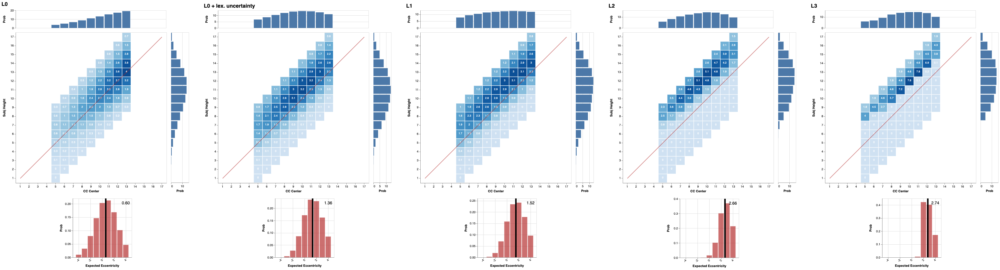

In [83]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMACmp cacheRef (0, UTall, denACmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMACmp >>= \l -> listener infoLUMACmp cacheRef (0, UTall, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMACmp cacheRef (1, UTall, denACmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMACmp cacheRef (2, UTall, denACmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMACmp cacheRef (3, UTall, denACmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> observe (Normal 9 4.0) (fromIntegral n) >> listener infoLUMACmp cacheRef (0, UTall, denACmp0 n))
  , ("L0 + lex. uncertainty", lp infoLUMACmp >>= \l -> listener infoLUMACmp cacheRef (0, UTall, l))
  , ("L1", listener infoLUMACmp cacheRef (1, UTall, denACmp0 midpoint))
  , ("L2", listener infoLUMACmp cacheRef (2, UTall, denACmp0 midpoint))
  , ("L3", listener infoLUMACmp cacheRef (3, UTall, denACmp0 midpoint))
  ]

#### Pragmatic listener hears:

> "John is shorter than Bill"

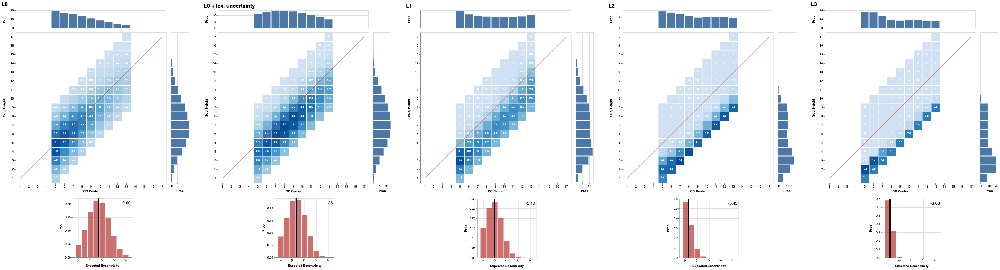

In [84]:
writeIORef cacheRef (0, Map.empty)
    
-- vlShow <$> mkGraph ("L0 literal listener", unif htsbill >>= \n -> listener infoLUMACmp cacheRef (0, UShrt, denACmp0 n))
-- vlShow <$> mkGraph ("L0 + lex. uncertainty", lp infoLUMACmp >>= \l -> listener infoLUMACmp cacheRef (0, UShrt, l))
-- vlShow <$> mkGraph ("L1 pragmatic listener", listener infoLUMACmp cacheRef (1, UShrt, denACmp0 midpoint))
-- vlShow <$> mkGraph ("L2 pragmatic listener", listener infoLUMACmp cacheRef (2, UShrt, denACmp0 midpoint))
-- vlShow <$> mkGraph ("L3 pragmatic listener", listener infoLUMACmp cacheRef (3, UShrt, denACmp0 midpoint))

vlShow . sidewaysDists <$> traverse mkGraph
  [ ("L0", unif htsbill >>= \n -> observe (Normal 9 4.0) (fromIntegral n) >> listener infoLUMACmp cacheRef (0, UShrt, denACmp0 n))
  , ("L0 + lex. uncertainty", lp infoLUMACmp >>= \l -> listener infoLUMACmp cacheRef (0, UShrt, l))
  , ("L1", listener infoLUMACmp cacheRef (1, UShrt, denACmp0 midpoint))
  , ("L2", listener infoLUMACmp cacheRef (2, UShrt, denACmp0 midpoint))
  , ("L3", listener infoLUMACmp cacheRef (3, UShrt, denACmp0 midpoint))
  ]